# 🎨 Data Designer Tutorial: Image-to-Image Editing

#### 📚 What you'll learn

This notebook shows how to chain image generation columns: first generate animal portraits from text, then edit those generated images by adding accessories and changing styles—all without loading external datasets.

- 🖼️ **Text-to-image generation**: Generate images from text prompts
- 🔗 **Chaining image columns**: Use `ImageContext` to pass generated images to a follow-up editing column
- 🎲 **Sampler-driven diversity**: Combine sampled accessories and settings for varied edits

This tutorial uses an **autoregressive** model (one that supports both text-to-image *and* image-to-image generation via the chat completions API). Diffusion models (DALL·E, Stable Diffusion, etc.) do not support image context—see [Tutorial 5](https://nvidia-nemo.github.io/DataDesigner/latest/notebooks/5-generating-images/) for text-to-image generation with diffusion models.

> **Prerequisites**: This tutorial uses [OpenRouter](https://openrouter.ai) with the Flux 2 Pro model. Set `OPENROUTER_API_KEY` in your environment before running.

If this is your first time using Data Designer, we recommend starting with the [first notebook](https://nvidia-nemo.github.io/DataDesigner/latest/notebooks/1-the-basics/) in this tutorial series.


### 📦 Import Data Designer

- `data_designer.config` provides the configuration API.
- `DataDesigner` is the main interface for generation.


In [1]:
import base64
from pathlib import Path

from IPython.display import Image as IPImage
from IPython.display import display

import data_designer.config as dd
from data_designer.interface import DataDesigner

### ⚙️ Initialize the Data Designer interface

We initialize Data Designer without arguments here—the image model is configured explicitly in the next cell.


In [2]:
data_designer = DataDesigner()

### 🎛️ Define an image model

We need an **autoregressive** model that supports both text-to-image and image-to-image generation via the chat completions API. This lets us generate images from text and then pass those images as context for editing.

- Use `ImageInferenceParams` so Data Designer treats this model as an image generator.
- Image-specific options are model-dependent; pass them via `extra_body`.

> **Note**: This tutorial uses the Flux 2 Pro model via [OpenRouter](https://openrouter.ai). Set `OPENROUTER_API_KEY` in your environment.


In [3]:
MODEL_PROVIDER = "openrouter"
MODEL_ID = "black-forest-labs/flux.2-pro"
MODEL_ALIAS = "image-model"

model_configs = [
    dd.ModelConfig(
        alias=MODEL_ALIAS,
        model=MODEL_ID,
        provider=MODEL_PROVIDER,
        inference_parameters=dd.ImageInferenceParams(
            extra_body={"height": 512, "width": 512},
        ),
    )
]

### 🏗️ Build the configuration

We chain two image generation columns:

1. **Sampler columns** — randomly sample animal types, accessories, settings, and art styles
2. **First image column** — generate an animal portrait from a text prompt
3. **Second image column with context** — edit the generated portrait using `ImageContext`


In [4]:
config_builder = dd.DataDesignerConfigBuilder(model_configs=model_configs)

# 1. Sampler columns for diversity
config_builder.add_column(
    dd.SamplerColumnConfig(
        name="animal",
        sampler_type=dd.SamplerType.CATEGORY,
        params=dd.CategorySamplerParams(
            values=["cat", "dog", "fox", "owl", "rabbit", "panda"],
        ),
    )
)

config_builder.add_column(
    dd.SamplerColumnConfig(
        name="accessory",
        sampler_type=dd.SamplerType.CATEGORY,
        params=dd.CategorySamplerParams(
            values=[
                "a tiny top hat",
                "oversized sunglasses",
                "a red bow tie",
                "a knitted beanie",
                "a flower crown",
                "a monocle and mustache",
                "a pirate hat and eye patch",
                "a chef hat",
            ],
        ),
    )
)

config_builder.add_column(
    dd.SamplerColumnConfig(
        name="setting",
        sampler_type=dd.SamplerType.CATEGORY,
        params=dd.CategorySamplerParams(
            values=[
                "a cozy living room",
                "a sunny park",
                "a photo studio with soft lighting",
                "a red carpet event",
                "a holiday card backdrop with snowflakes",
                "a tropical beach at sunset",
            ],
        ),
    )
)

config_builder.add_column(
    dd.SamplerColumnConfig(
        name="art_style",
        sampler_type=dd.SamplerType.CATEGORY,
        params=dd.CategorySamplerParams(
            values=[
                "a photorealistic style",
                "a Disney Pixar 3D render",
                "a watercolor painting",
                "a pop art poster",
            ],
        ),
    )
)

# 2. Generate animal portrait from text
config_builder.add_column(
    dd.ImageColumnConfig(
        name="animal_portrait",
        prompt="A close-up portrait photograph of a {{ animal }} looking at the camera, studio lighting, high quality.",
        model_alias=MODEL_ALIAS,
    )
)

# 3. Edit the generated portrait
config_builder.add_column(
    dd.ImageColumnConfig(
        name="edited_portrait",
        prompt=(
            "Edit this {{ animal }} portrait photo. "
            "Add {{ accessory }} on the animal. "
            "Place the {{ animal }} in {{ setting }}. "
            "Render the result in {{ art_style }}. "
            "Keep the animal's face, expression, and features faithful to the original photo."
        ),
        model_alias=MODEL_ALIAS,
        multi_modal_context=[dd.ImageContext(column_name="animal_portrait")],
    )
)

data_designer.validate(config_builder)

[16:33:11] [INFO] ✅ Validation passed


### 🔁 Preview: quick iteration

In **preview** mode, generated images are stored as base64 strings in the dataframe. Use this to iterate on your prompts, accessories, and sampler values before scaling up.


In [5]:
preview = data_designer.preview(config_builder, num_records=2)

[16:33:11] [INFO] 🕵️ Preview generation in progress


[16:33:11] [INFO] ✅ Validation passed


[16:33:12] [INFO] ⛓️ Sorting column configs into a Directed Acyclic Graph


[16:33:12] [INFO] 🩺 Running health checks for models...


[16:33:12] [INFO]   |-- 👀 Checking 'black-forest-labs/flux.2-pro' in provider named 'openrouter' for model alias 'image-model'...


[16:33:23] [INFO]   |-- ✅ Passed!


[16:33:23] [INFO] 🎲 Preparing samplers to generate 2 records across 4 columns


[16:33:23] [INFO] 🖼️ image model config for column 'animal_portrait'


[16:33:23] [INFO]   |-- model: 'black-forest-labs/flux.2-pro'


[16:33:23] [INFO]   |-- model alias: 'image-model'


[16:33:23] [INFO]   |-- model provider: 'openrouter'


[16:33:23] [INFO]   |-- inference parameters:


[16:33:23] [INFO]   |  |-- generation_type=image


[16:33:23] [INFO]   |  |-- max_parallel_requests=4


[16:33:23] [INFO]   |  |-- extra_body={'height': 512, 'width': 512}


[16:33:23] [INFO] ⚡️ Processing image column 'animal_portrait' with 4 concurrent workers


[16:33:23] [INFO] ⏱️ image column 'animal_portrait' will report progress after each record


[16:33:32] [INFO]   |-- 🌗 image column 'animal_portrait' progress: 1/2 (50%) complete, 1 ok, 0 failed, 0.11 rec/s, eta 8.9s


[16:33:33] [INFO]   |-- 🌕 image column 'animal_portrait' progress: 2/2 (100%) complete, 2 ok, 0 failed, 0.20 rec/s, eta 0.0s


[16:33:33] [INFO] 🖼️ image model config for column 'edited_portrait'


[16:33:33] [INFO]   |-- model: 'black-forest-labs/flux.2-pro'


[16:33:33] [INFO]   |-- model alias: 'image-model'


[16:33:33] [INFO]   |-- model provider: 'openrouter'


[16:33:33] [INFO]   |-- inference parameters:


[16:33:33] [INFO]   |  |-- generation_type=image


[16:33:33] [INFO]   |  |-- max_parallel_requests=4


[16:33:33] [INFO]   |  |-- extra_body={'height': 512, 'width': 512}


[16:33:33] [INFO] ⚡️ Processing image column 'edited_portrait' with 4 concurrent workers


[16:33:33] [INFO] ⏱️ image column 'edited_portrait' will report progress after each record


[16:33:49] [INFO]   |-- ⛅ image column 'edited_portrait' progress: 1/2 (50%) complete, 1 ok, 0 failed, 0.06 rec/s, eta 16.1s


[16:33:55] [INFO]   |-- ☀️ image column 'edited_portrait' progress: 2/2 (100%) complete, 2 ok, 0 failed, 0.09 rec/s, eta 0.0s


[16:33:56] [INFO] 📊 Model usage summary:


[16:33:56] [INFO]   |-- model: black-forest-labs/flux.2-pro


[16:33:56] [INFO]   |-- tokens: input=0, output=0, total=0, tps=0


[16:33:56] [INFO]   |-- requests: success=4, failed=0, total=4, rpm=7


[16:33:56] [INFO]   |-- images: total=4


[16:33:56] [INFO] 📐 Measuring dataset column statistics:


[16:33:56] [INFO]   |-- 🎲 column: 'animal'


[16:33:56] [INFO]   |-- 🎲 column: 'accessory'


[16:33:56] [INFO]   |-- 🎲 column: 'setting'


[16:33:56] [INFO]   |-- 🎲 column: 'art_style'


[16:33:56] [INFO]   |-- 🖼️ column: 'animal_portrait'


[16:33:56] [INFO]   |-- 🖼️ column: 'edited_portrait'


[16:33:56] [INFO] 🥳 Preview complete!


                                              Generated Columns                                               
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                  ┃ Value                                                                              ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ animal                │ dog                                                                                │
├───────────────────────┼────────────────────────────────────────────────────────────────────────────────────┤
│ accessory             │ a monocle and mustache                                                             │
├───────────────────────┼────────────────────────────────────────────────────────────────────────────────────┤
│ setting               │ a holiday card backdrop with snowflakes                                            │
├───────────────────────┼────────────────────────────────────────────────────────────────────────────────────┤
│ art_style             │ a Disney Pixar 3D render                                                           │
└───────────────────────┴────────────────────────────────────────────────────────────────────────────────────┘
                                                                                                              
                                                                                                              
                                                    Images                                                    
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                                   ┃ Preview                                                           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ animal_portrait                        │ [0] <base64, 1562148 chars>                                       │
├────────────────────────────────────────┼───────────────────────────────────────────────────────────────────┤
│ edited_portrait                        │ [0] <base64, 1694840 chars>                                       │
└────────────────────────────────────────┴───────────────────────────────────────────────────────────────────┘
                                                                                                              
                                                  [index: 0]


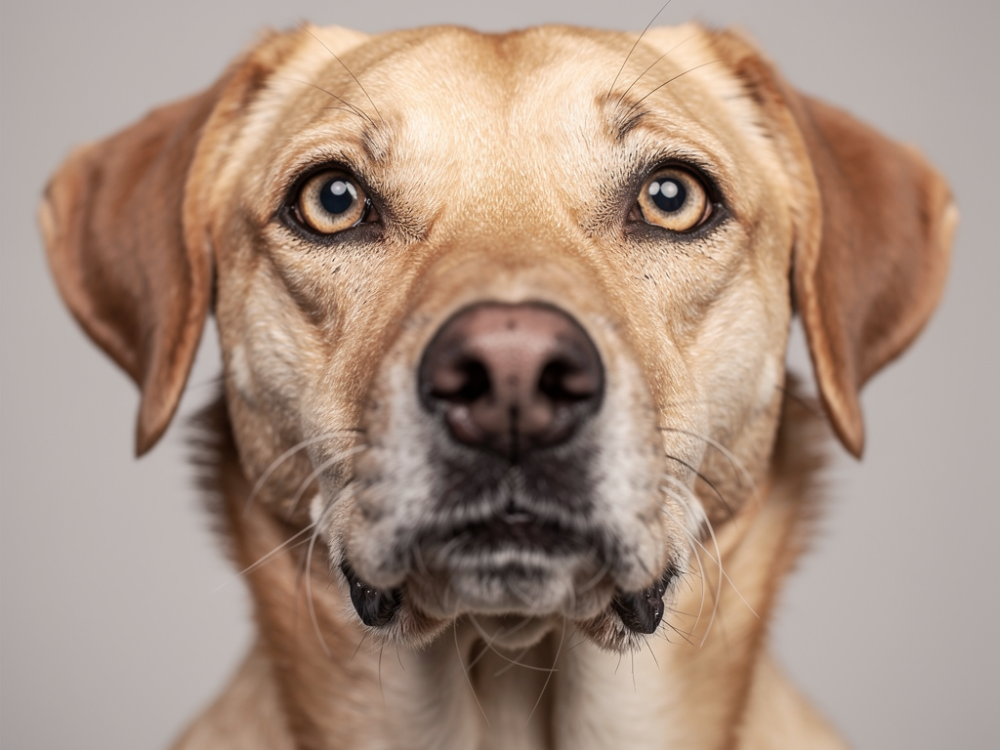


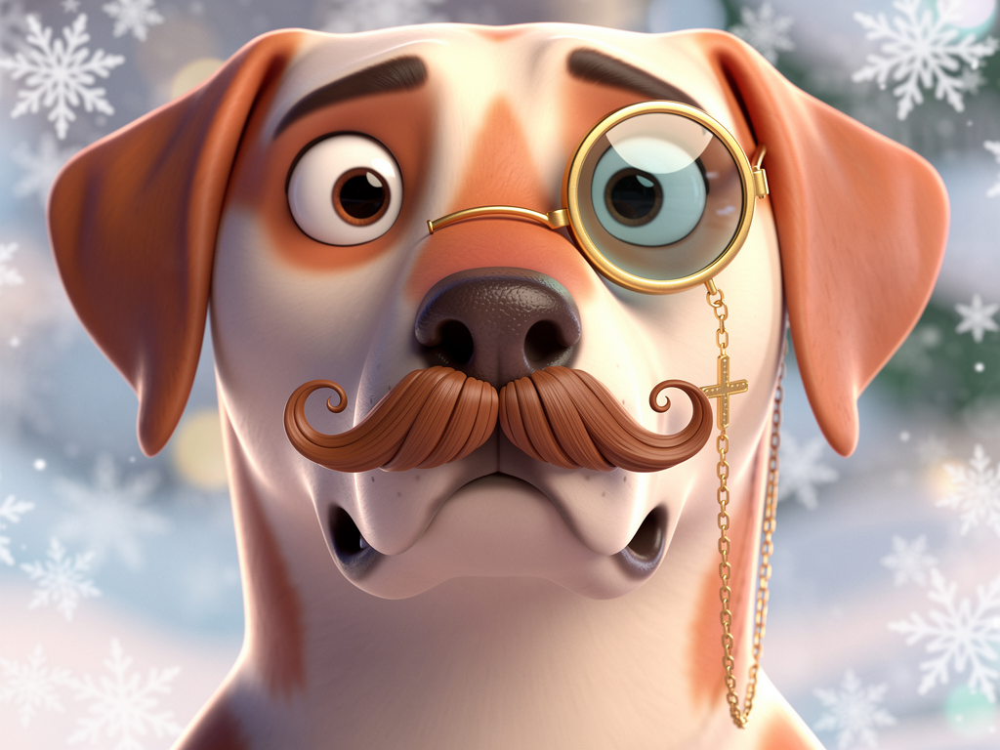

                                              Generated Columns                                               
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                              ┃ Value                                                                  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ animal                            │ dog                                                                    │
├───────────────────────────────────┼────────────────────────────────────────────────────────────────────────┤
│ accessory                         │ a chef hat                                                             │
├───────────────────────────────────┼────────────────────────────────────────────────────────────────────────┤
│ setting                           │ a red carpet event                                                     │
├───────────────────────────────────┼────────────────────────────────────────────────────────────────────────┤
│ art_style                         │ a watercolor painting                                                  │
└───────────────────────────────────┴────────────────────────────────────────────────────────────────────────┘
                                                                                                              
                                                                                                              
                                                    Images                                                    
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Name                                   ┃ Preview                                                           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ animal_portrait                        │ [0] <base64, 1800736 chars>                                       │
├────────────────────────────────────────┼───────────────────────────────────────────────────────────────────┤
│ edited_portrait                        │ [0] <base64, 2060276 chars>                                       │
└────────────────────────────────────────┴───────────────────────────────────────────────────────────────────┘
                                                                                                              
                                                  [index: 1]


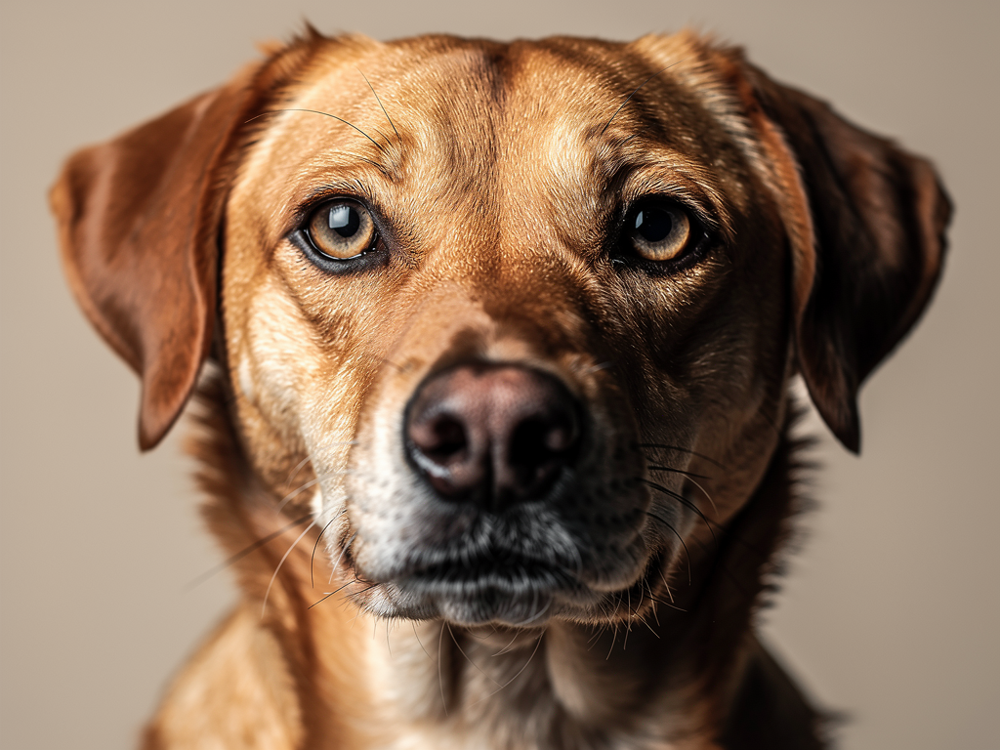


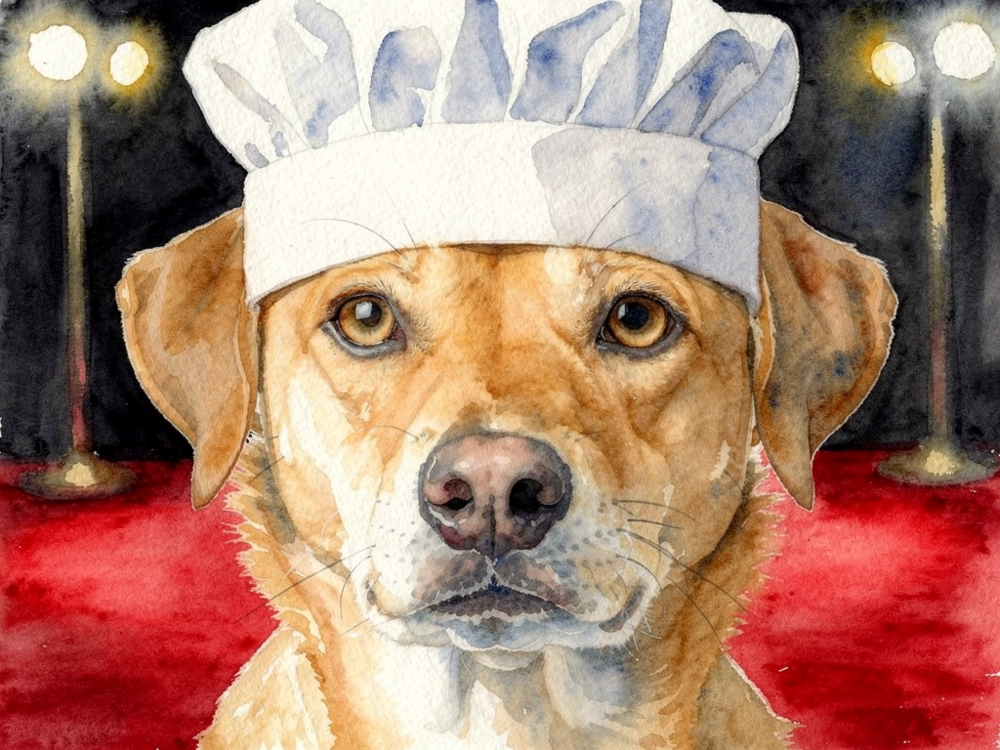

In [6]:
for i in range(len(preview.dataset)):
    preview.display_sample_record()

In [7]:
preview.dataset

,animal,accessory,setting,art_style,animal_portrait,edited_portrait
0,dog,a monocle and mustache,a holiday card backdrop with snowflakes,a Disney Pixar 3D render,[iVBORw0KGgoAAAANSUhEUgAABAAAAAMACAIAAAA12IJaA...,[iVBORw0KGgoAAAANSUhEUgAABAAAAAMACAIAAAA12IJaA...
1,dog,a chef hat,a red carpet event,a watercolor painting,[iVBORw0KGgoAAAANSUhEUgAABAAAAAMACAIAAAA12IJaA...,[iVBORw0KGgoAAAANSUhEUgAABAAAAAMACAIAAAA12IJaA...


### 🔎 Compare original vs edited

Let's display the generated animal portraits next to their edited versions.


In [8]:
def display_image(image_value, base_path: Path | None = None) -> None:
    """Display an image from base64 (preview mode) or file path (create mode)."""
    values = [image_value] if isinstance(image_value, str) else list(image_value)
    for value in values:
        if base_path is not None:
            display(IPImage(filename=str(base_path / value)))
        else:
            display(IPImage(data=base64.b64decode(value)))


def display_before_after(row, index: int, base_path: Path | None = None) -> None:
    """Display original portrait vs edited version for a single record."""
    print(f"\n{'=' * 60}")
    print(f"Record {index}: {row['animal']} wearing {row['accessory']}")
    print(f"Setting: {row['setting']}, Style: {row['art_style']}")
    print(f"{'=' * 60}")

    print("\n📷 Generated portrait:")
    display_image(row["animal_portrait"], base_path)

    print("\n🎨 Edited version:")
    display_image(row["edited_portrait"], base_path)


Record 0: dog wearing a monocle and mustache
Setting: a holiday card backdrop with snowflakes, Style: a Disney Pixar 3D render

📷 Generated portrait:


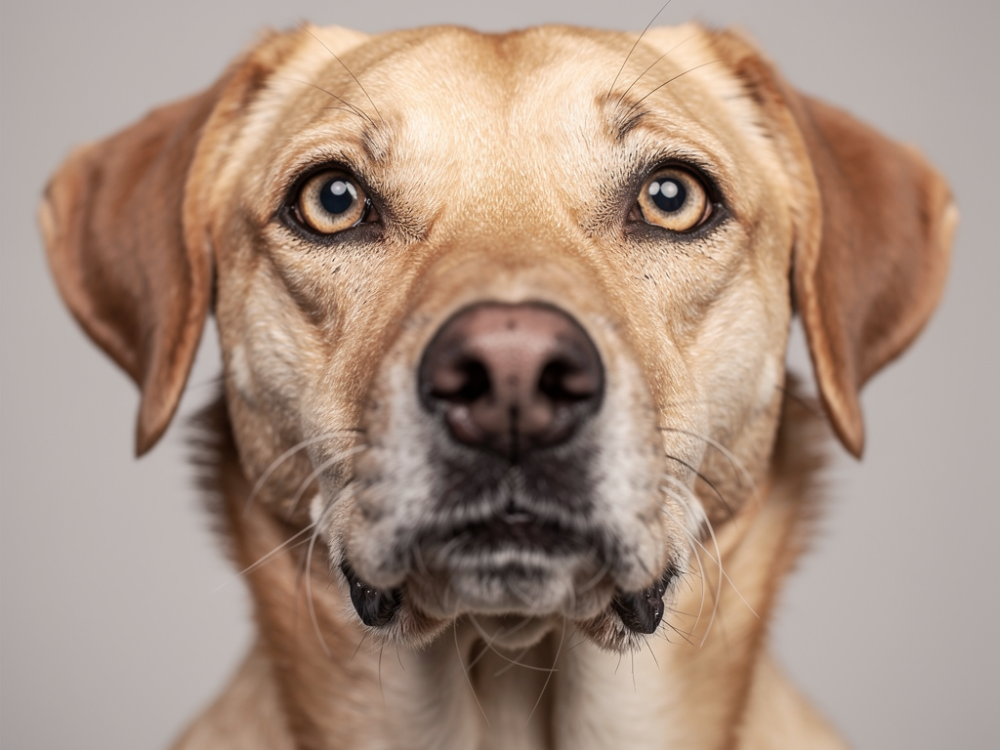


🎨 Edited version:


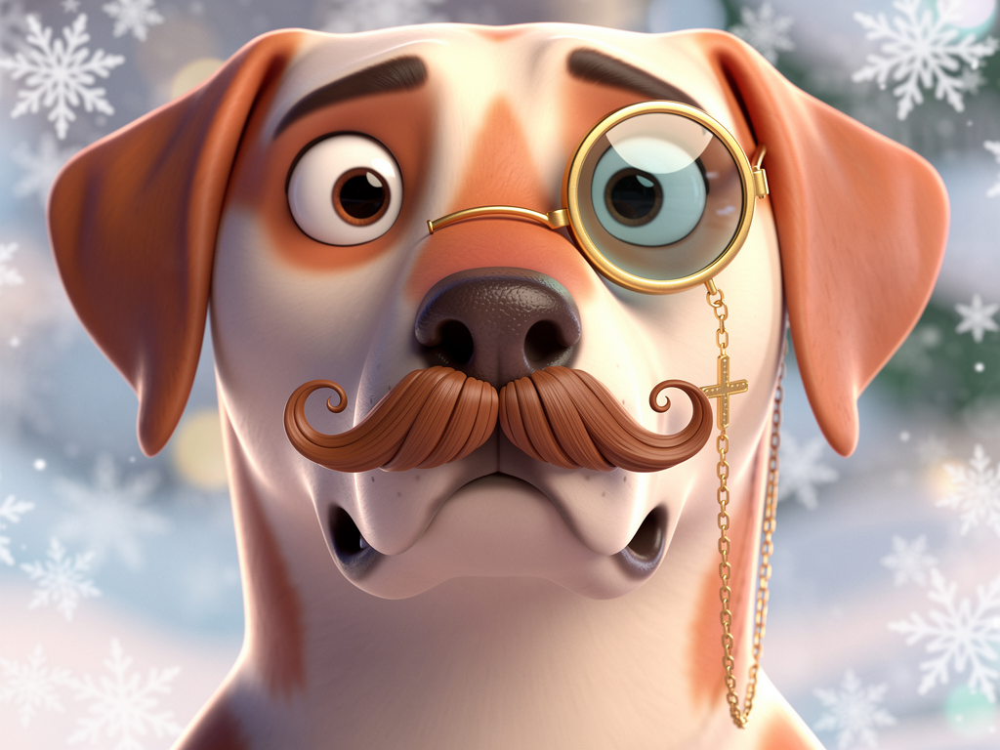


Record 1: dog wearing a chef hat
Setting: a red carpet event, Style: a watercolor painting

📷 Generated portrait:


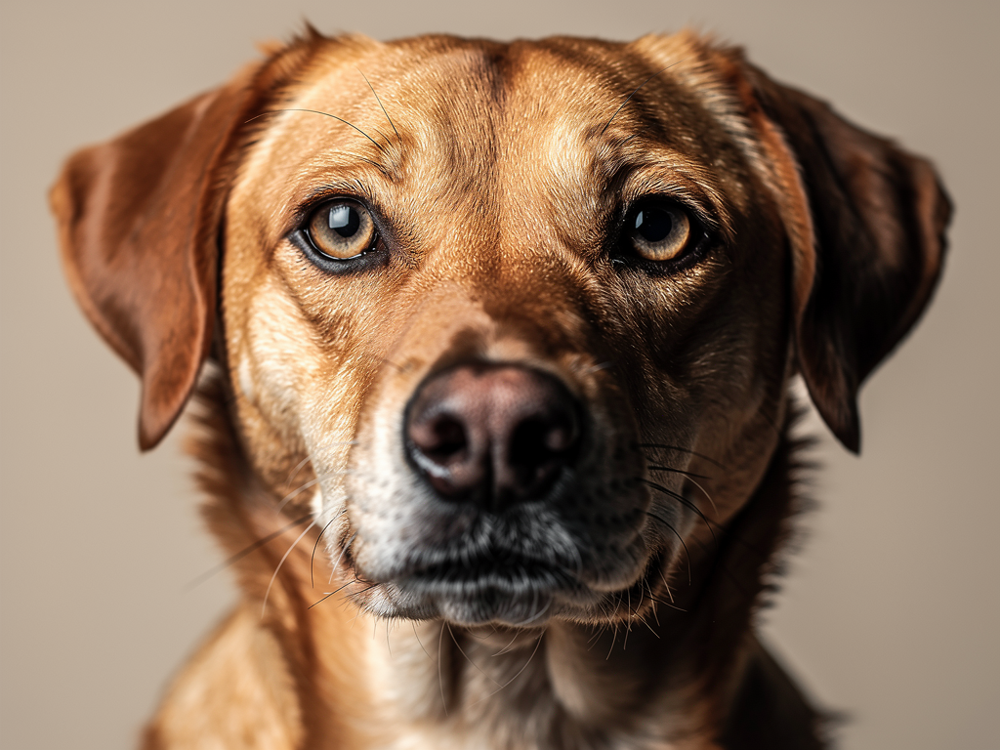


🎨 Edited version:


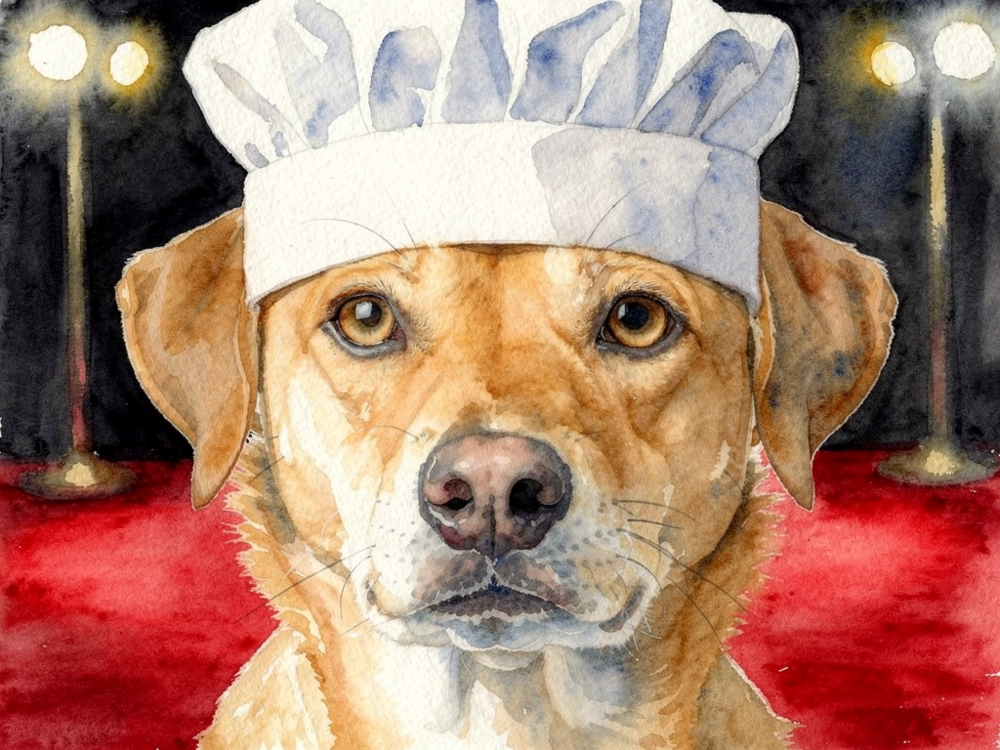

In [9]:
for index, row in preview.dataset.iterrows():
    display_before_after(row, index)

### 🆙 Create at scale

In **create** mode, images are saved to disk in `images/<column_name>/` folders with UUID filenames. The dataframe stores relative paths. `ImageContext` auto-detection handles this transparently—generated file paths are resolved to base64 before being sent to the model for editing.


In [10]:
results = data_designer.create(config_builder, num_records=5, dataset_name="tutorial-6-edited-images")

[16:33:56] [INFO] 🎨 Creating Data Designer dataset


[16:33:56] [INFO] ✅ Validation passed


[16:33:56] [INFO] ⛓️ Sorting column configs into a Directed Acyclic Graph


[16:33:56] [INFO] 🩺 Running health checks for models...


[16:33:56] [INFO]   |-- 👀 Checking 'black-forest-labs/flux.2-pro' in provider named 'openrouter' for model alias 'image-model'...


[16:34:13] [INFO]   |-- ✅ Passed!


[16:34:13] [INFO] ⏳ Processing batch 1 of 1


[16:34:13] [INFO] 🎲 Preparing samplers to generate 5 records across 4 columns


[16:34:13] [INFO] 🖼️ image model config for column 'animal_portrait'


[16:34:13] [INFO]   |-- model: 'black-forest-labs/flux.2-pro'


[16:34:13] [INFO]   |-- model alias: 'image-model'


[16:34:13] [INFO]   |-- model provider: 'openrouter'


[16:34:13] [INFO]   |-- inference parameters:


[16:34:13] [INFO]   |  |-- generation_type=image


[16:34:13] [INFO]   |  |-- max_parallel_requests=4


[16:34:13] [INFO]   |  |-- extra_body={'height': 512, 'width': 512}


[16:34:13] [INFO] ⚡️ Processing image column 'animal_portrait' with 4 concurrent workers


[16:34:13] [INFO] ⏱️ image column 'animal_portrait' will report progress after each record


[16:34:23] [INFO]   |-- 🌧️ image column 'animal_portrait' progress: 1/5 (20%) complete, 1 ok, 0 failed, 0.10 rec/s, eta 41.6s


[16:34:24] [INFO]   |-- 🌦️ image column 'animal_portrait' progress: 2/5 (40%) complete, 2 ok, 0 failed, 0.18 rec/s, eta 16.3s


[16:34:25] [INFO]   |-- ⛅ image column 'animal_portrait' progress: 3/5 (60%) complete, 3 ok, 0 failed, 0.25 rec/s, eta 7.9s


[16:34:36] [INFO]   |-- 🌤️ image column 'animal_portrait' progress: 4/5 (80%) complete, 4 ok, 0 failed, 0.18 rec/s, eta 5.7s


[16:34:40] [INFO]   |-- ☀️ image column 'animal_portrait' progress: 5/5 (100%) complete, 5 ok, 0 failed, 0.18 rec/s, eta 0.0s


[16:34:40] [INFO] 🖼️ image model config for column 'edited_portrait'


[16:34:40] [INFO]   |-- model: 'black-forest-labs/flux.2-pro'


[16:34:40] [INFO]   |-- model alias: 'image-model'


[16:34:40] [INFO]   |-- model provider: 'openrouter'


[16:34:40] [INFO]   |-- inference parameters:


[16:34:40] [INFO]   |  |-- generation_type=image


[16:34:40] [INFO]   |  |-- max_parallel_requests=4


[16:34:40] [INFO]   |  |-- extra_body={'height': 512, 'width': 512}


[16:34:40] [INFO] ⚡️ Processing image column 'edited_portrait' with 4 concurrent workers


[16:34:40] [INFO] ⏱️ image column 'edited_portrait' will report progress after each record


[16:34:57] [INFO]   |-- 😴 image column 'edited_portrait' progress: 1/5 (20%) complete, 1 ok, 0 failed, 0.06 rec/s, eta 65.8s


[16:35:04] [INFO]   |-- 🥱 image column 'edited_portrait' progress: 2/5 (40%) complete, 2 ok, 0 failed, 0.08 rec/s, eta 36.4s


[16:35:23] [INFO]   |-- 😐 image column 'edited_portrait' progress: 3/5 (60%) complete, 3 ok, 0 failed, 0.07 rec/s, eta 28.5s


[16:35:27] [INFO]   |-- 😊 image column 'edited_portrait' progress: 4/5 (80%) complete, 4 ok, 0 failed, 0.08 rec/s, eta 11.8s


[16:37:54] [INFO]   |-- 🤩 image column 'edited_portrait' progress: 5/5 (100%) complete, 5 ok, 0 failed, 0.03 rec/s, eta 0.0s


[16:37:54] [INFO] 📊 Model usage summary:


[16:37:54] [INFO]   |-- model: black-forest-labs/flux.2-pro


[16:37:54] [INFO]   |-- tokens: input=0, output=0, total=0, tps=0


[16:37:54] [INFO]   |-- requests: success=10, failed=0, total=10, rpm=2


[16:37:54] [INFO]   |-- images: total=10


[16:37:54] [INFO] 📐 Measuring dataset column statistics:


[16:37:54] [INFO]   |-- 🎲 column: 'animal'


[16:37:54] [INFO]   |-- 🎲 column: 'accessory'


[16:37:54] [INFO]   |-- 🎲 column: 'setting'


[16:37:54] [INFO]   |-- 🎲 column: 'art_style'


[16:37:54] [INFO]   |-- 🖼️ column: 'animal_portrait'


[16:37:54] [INFO]   |-- 🖼️ column: 'edited_portrait'


In [11]:
dataset = results.load_dataset()
dataset.head()

,animal,accessory,setting,art_style,animal_portrait,edited_portrait
0,dog,a monocle and mustache,a holiday card backdrop with snowflakes,a photorealistic style,['images/animal_portrait/072b06f8-48bb-4745-8e...,['images/edited_portrait/a001edd1-73b1-400e-ad...
1,rabbit,a tiny top hat,a photo studio with soft lighting,a pop art poster,['images/animal_portrait/9831e4d9-eef6-482f-82...,['images/edited_portrait/f11a5584-dd27-486d-85...
2,dog,a pirate hat and eye patch,a red carpet event,a photorealistic style,['images/animal_portrait/345f85d0-4f80-48cb-a2...,['images/edited_portrait/43b0e7fc-a988-46fb-b4...
3,panda,a pirate hat and eye patch,a red carpet event,a pop art poster,['images/animal_portrait/815c9012-1163-483d-80...,['images/edited_portrait/93470285-a8b4-4ba5-93...
4,rabbit,a tiny top hat,a cozy living room,a watercolor painting,['images/animal_portrait/91bacdf2-5142-4255-bc...,['images/edited_portrait/a807c41b-5c5d-43cd-be...



Record 0: dog wearing a monocle and mustache
Setting: a holiday card backdrop with snowflakes, Style: a photorealistic style

📷 Generated portrait:


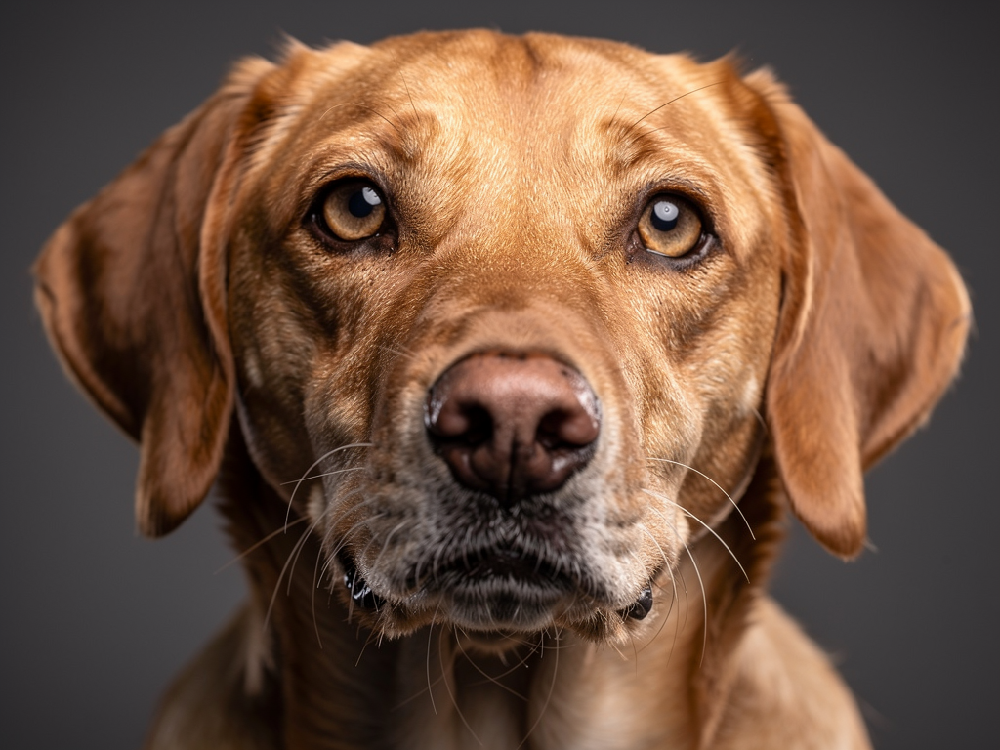


🎨 Edited version:


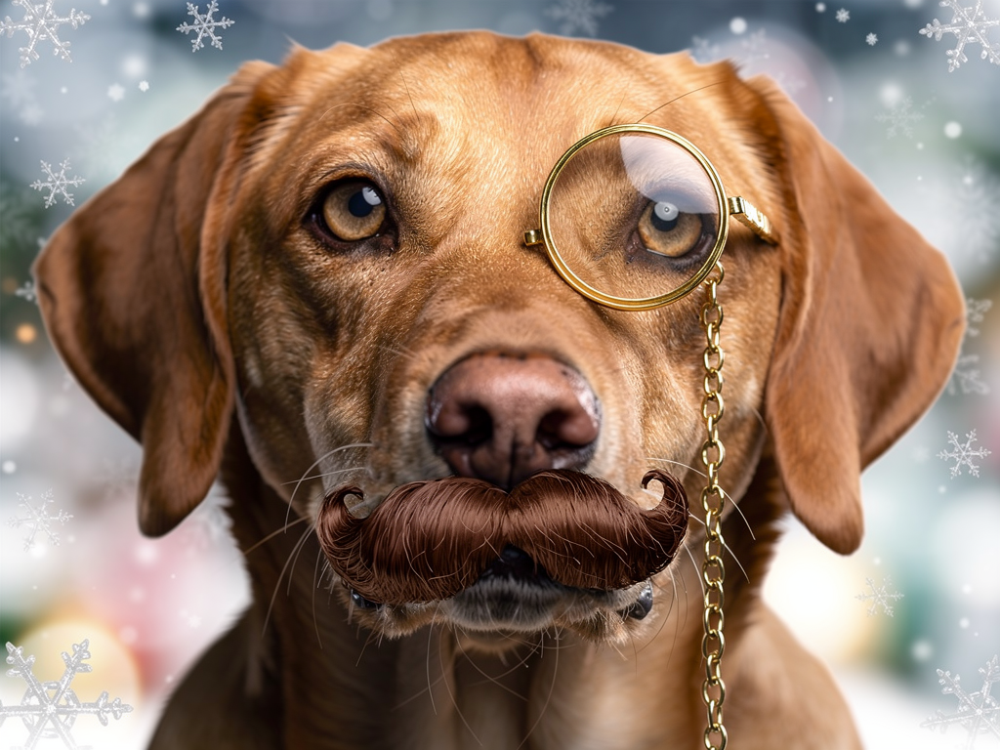


Record 1: rabbit wearing a tiny top hat
Setting: a photo studio with soft lighting, Style: a pop art poster

📷 Generated portrait:


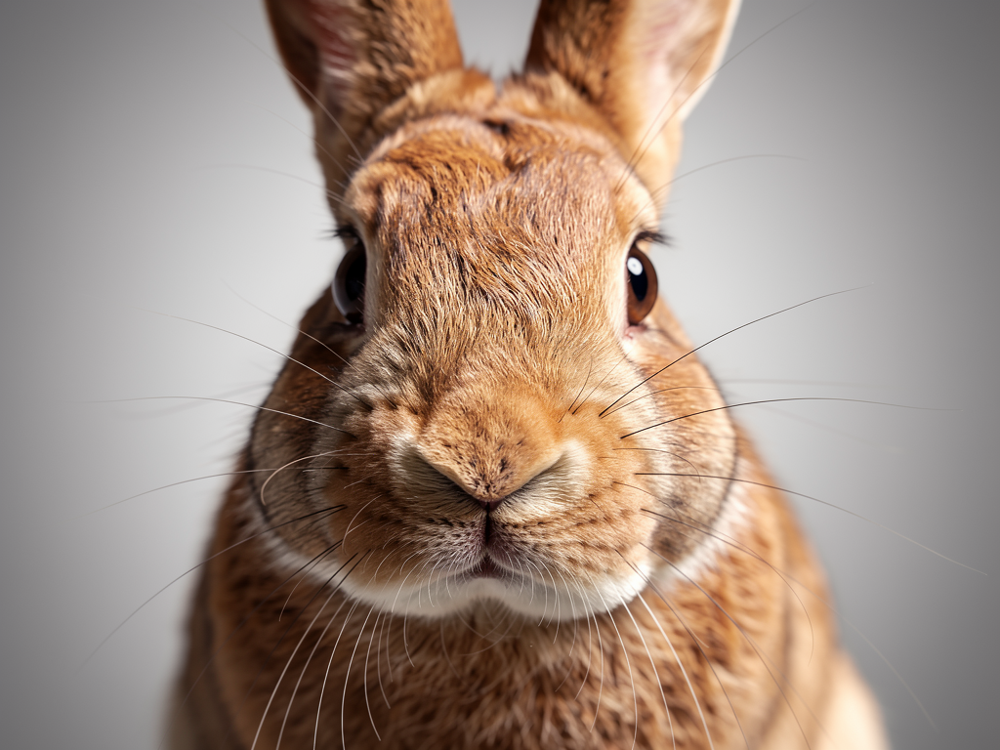


🎨 Edited version:


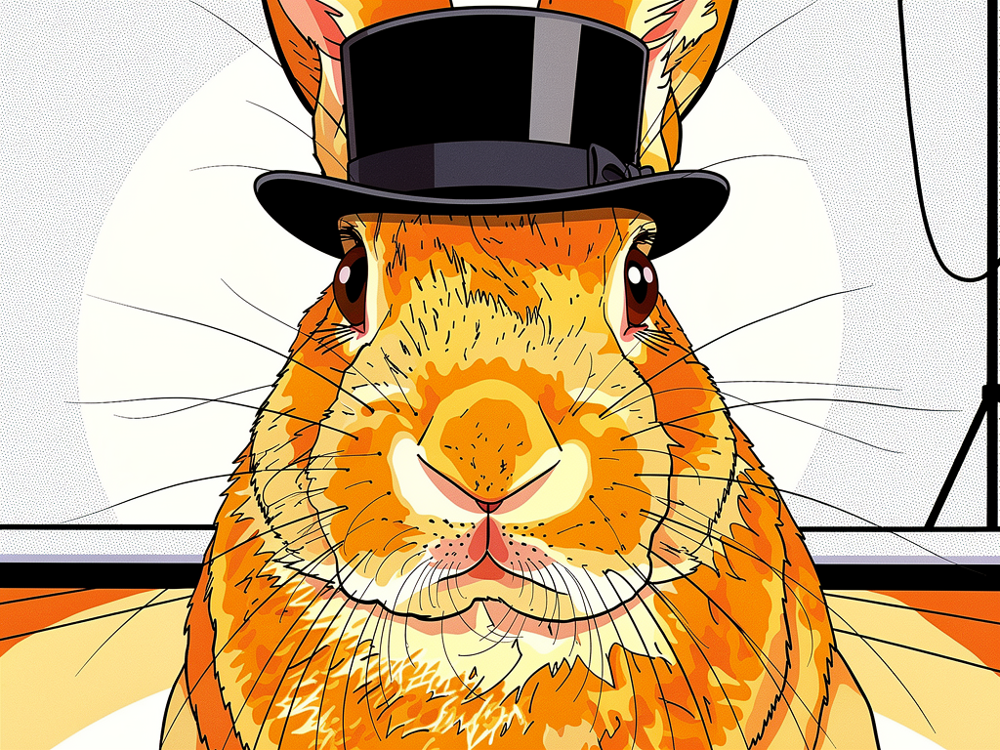


Record 2: dog wearing a pirate hat and eye patch
Setting: a red carpet event, Style: a photorealistic style

📷 Generated portrait:


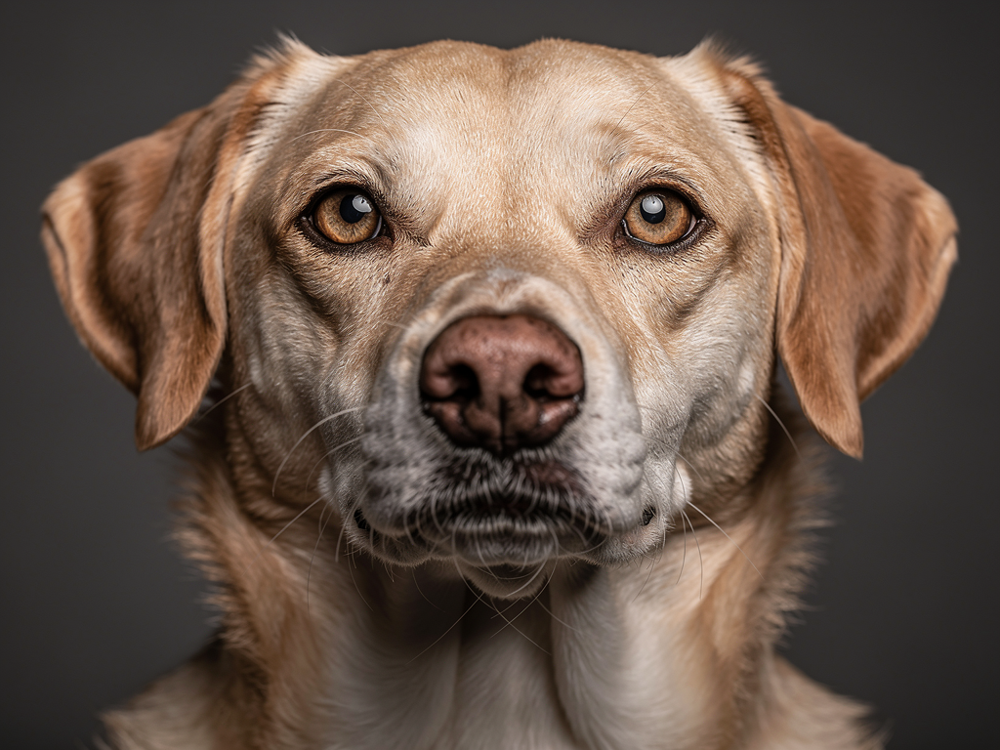


🎨 Edited version:


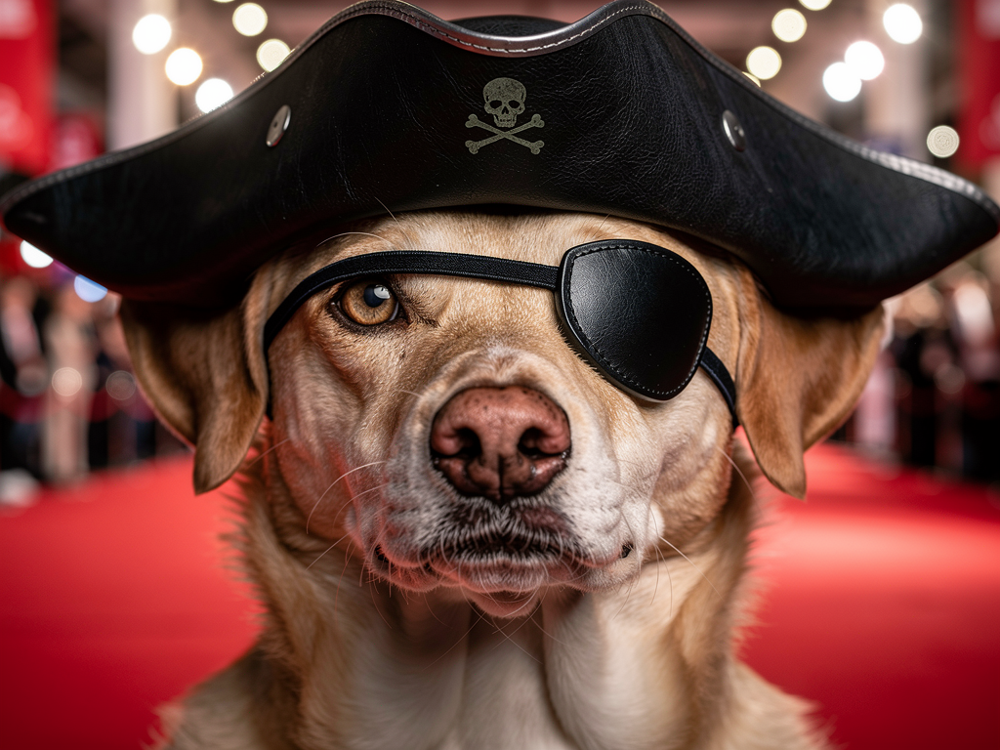


Record 3: panda wearing a pirate hat and eye patch
Setting: a red carpet event, Style: a pop art poster

📷 Generated portrait:


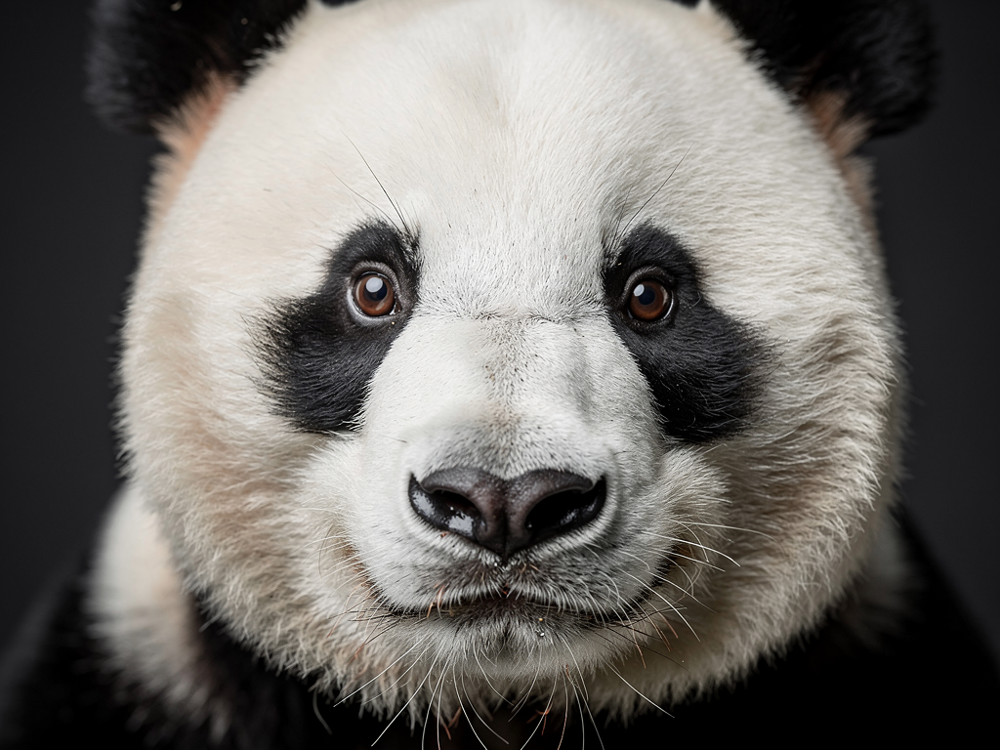


🎨 Edited version:


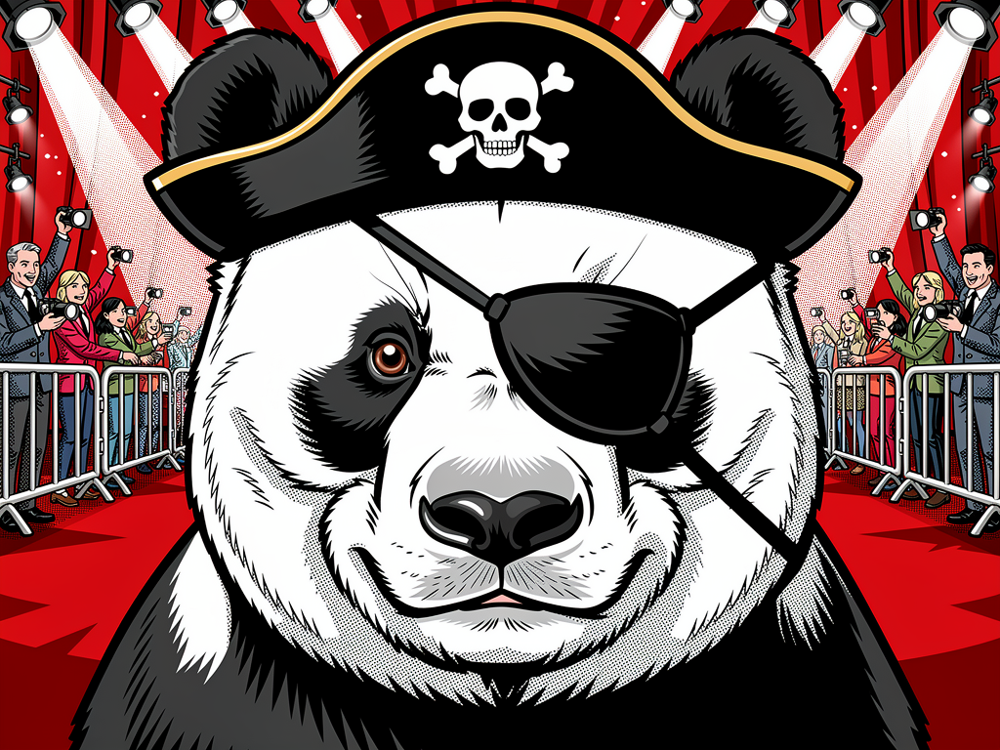


Record 4: rabbit wearing a tiny top hat
Setting: a cozy living room, Style: a watercolor painting

📷 Generated portrait:


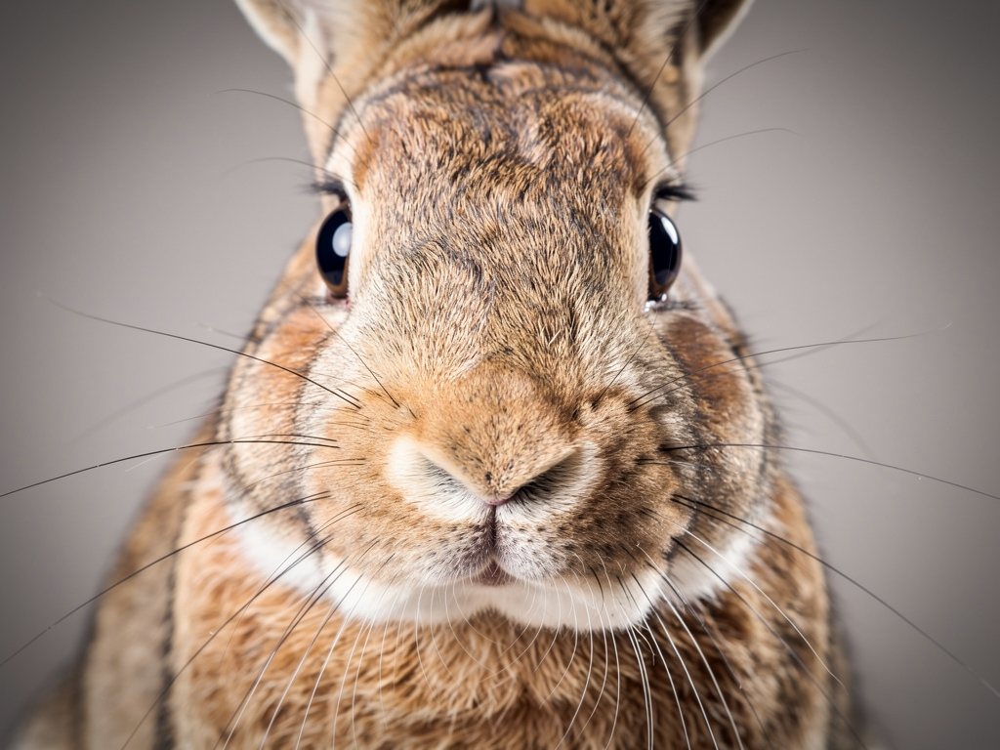


🎨 Edited version:


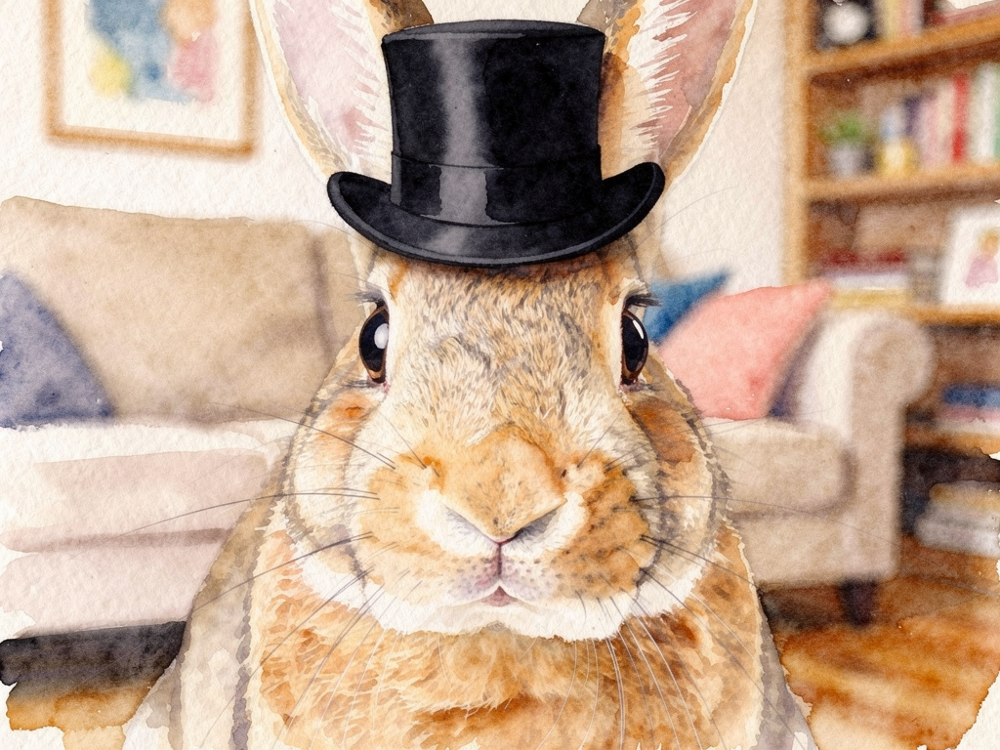

In [12]:
for index, row in dataset.head(10).iterrows():
    display_before_after(row, index, base_path=results.artifact_storage.base_dataset_path)

## ⏭️ Next steps

- Experiment with different autoregressive models for image generation and editing
- Try more creative editing prompts (style transfer, background replacement, artistic filters)
- Combine image generation with text generation (e.g., generate captions using an LLM-Text column with `ImageContext`)
- Chain more than two image columns for multi-step editing pipelines

Related tutorials:

- [The basics](https://nvidia-nemo.github.io/DataDesigner/latest/notebooks/1-the-basics/): samplers and LLM text columns
- [Providing images as context](https://nvidia-nemo.github.io/DataDesigner/latest/notebooks/4-providing-images-as-context/): image-to-text with VLMs
- [Generating images](https://nvidia-nemo.github.io/DataDesigner/latest/notebooks/5-generating-images/): text-to-image generation with diffusion models
